Author:Syed Nazmul KAbir

Model Building for Retail Sales Prediction

### 1.1.1 Create SparkSession<a class="anchor" id="1.1.1"></a>
[Back to top](#table)

Write the code to get a SparkSession. For creating the SparkSession, you need to use a SparkConf object to configure the Spark app with a proper application name, to enable the maximum partition size not exceed 10MB, and to run locally with as many working processors as local cores on your machine

In [1]:
# Import SparkConf and SparkSession class into program
from pyspark import SparkConf
from pyspark.sql import SparkSession

# local[*]: run Spark in local mode with as many working processors as logical cores on your machine
master = "local[*]"

# The `appName` field is a name to be shown on the Spark cluster UI page
app_name = "Predict Future Sales"

# Setup configuration parameters for Spark
spark_conf = SparkConf().setMaster(master).setAppName(app_name). \
                set('spark.sql.files.maxPartitionBytes', '10000000') 


# Creating Spark Configuration Object
spark = SparkSession.builder.config(conf=spark_conf).getOrCreate()

# Creating SparkSession

sc = spark.sparkContext
sc.setLogLevel('ERROR')

### 1.1.2 Define schemas<a class="anchor" id="1.1.1"></a>
[Back to top](#table)

Write code to define the data schema for features, sales and stores datasets, following the data types suggested in the metadata file.

In [2]:
from pyspark.sql.types import StructType,StructField, StringType, IntegerType, DoubleType, DateType, BooleanType, TimestampType
import pyspark.sql.functions as f
from pyspark.sql.functions import col

In [3]:
schema_features = StructType() \
      .add("Store",StringType(),True) \
      .add("Date",DateType(),True) \
      .add("Temperature",DoubleType(),True) \
      .add("Fuel_Price",DoubleType(),True) \
      .add("MarkDown1",DoubleType(),True) \
      .add("MarkDown2",DoubleType(),True) \
      .add("MarkDown3",DoubleType(),True) \
      .add("MarkDown4",DoubleType(),True) \
      .add("MarkDown5",DoubleType(),True) \
      .add("CPI",DoubleType(),True) \
      .add("Unemployment",DoubleType(),True) \
      .add("IsHoliday",BooleanType(),True)


# Creating schema for the sales dataframe
schema_sales = StructType() \
      .add("Store",StringType(),True) \
      .add("Dept",StringType(),True) \
      .add("Date",DateType(),True) \
      .add("Weekly_Sales",DoubleType(),True) \
      .add("IsHoliday",BooleanType(),True)


# Creating stores schema for the sales dataframe
schema_stores = StructType() \
      .add("Store",StringType(),True) \
      .add("Type",StringType(),True) \
      .add("Size",IntegerType(),True)

### 1.1.3 Load three DF<a class="anchor" id="1.1.1"></a>
[Back to top](#table)

Using predefined schema, write code to load the features, sales and stores csv files into separate dataframes. Print the schemas for all of the dataframes

In [4]:
# Importing features.csv using defined schema for the features
df_features = spark.read.format("csv") \
      .option("header", True) \
      .option("dateFormat", "dd/MM/yyyy") \
      .schema(schema_features) \
      .load("data/features.csv")

# Importing sales.csv using defined schema for the features
df_sales = spark.read.format("csv") \
      .option("header", True) \
      .option("dateFormat", "dd/MM/yyyy") \
      .schema(schema_sales) \
      .load("data/sales.csv")

# Importing stores.csv using defined schema for the features
df_stores = spark.read.format("csv") \
      .option("header", True) \
      .schema(schema_stores) \
      .load("data/stores.csv")

In [5]:
df_features.printSchema()

root
 |-- Store: string (nullable = true)
 |-- Date: date (nullable = true)
 |-- Temperature: double (nullable = true)
 |-- Fuel_Price: double (nullable = true)
 |-- MarkDown1: double (nullable = true)
 |-- MarkDown2: double (nullable = true)
 |-- MarkDown3: double (nullable = true)
 |-- MarkDown4: double (nullable = true)
 |-- MarkDown5: double (nullable = true)
 |-- CPI: double (nullable = true)
 |-- Unemployment: double (nullable = true)
 |-- IsHoliday: boolean (nullable = true)



In [6]:
df_sales.printSchema()

root
 |-- Store: string (nullable = true)
 |-- Dept: string (nullable = true)
 |-- Date: date (nullable = true)
 |-- Weekly_Sales: double (nullable = true)
 |-- IsHoliday: boolean (nullable = true)



In [7]:
df_stores.printSchema()

root
 |-- Store: string (nullable = true)
 |-- Type: string (nullable = true)
 |-- Size: integer (nullable = true)



### 1.2.1 Exploring the data<a class="anchor" id="1.1.1"></a>
[Back to top](#table)

Write code to show the total ‘null’ counts for each column in all of the three dataframes.

In [8]:
from pyspark.sql.functions import col,isnan, when, count

In [9]:
def counting_null(data):
    
    p = data.select([count(when(col(c).contains('None') | \
                            col(c).contains('NULL') | \
                            (col(c) == '' ) | \
                            col(c).isNull() | \
                            isnan(c), c 
                           )).alias(c)
                    for c in data.columns])
    return p.show() 

In [10]:
df_features_dateString = df_features.withColumn('Date', df_features.Date.cast('string')). \
                                     withColumn('IsHoliday', df_features.IsHoliday.cast('string'))
counting_null(df_features_dateString)

+-----+----+-----------+----------+---------+---------+---------+---------+---------+---+------------+---------+
|Store|Date|Temperature|Fuel_Price|MarkDown1|MarkDown2|MarkDown3|MarkDown4|MarkDown5|CPI|Unemployment|IsHoliday|
+-----+----+-----------+----------+---------+---------+---------+---------+---------+---+------------+---------+
|    0|   0|          0|         0|     4158|     5269|     4577|     4726|     4140|585|         585|        0|
+-----+----+-----------+----------+---------+---------+---------+---------+---------+---+------------+---------+



In [11]:
df_sales_dateString = df_sales.withColumn('Date', df_sales.Date.cast('string')). \
                               withColumn('IsHoliday', df_sales.IsHoliday.cast('string'))
counting_null(df_sales_dateString)

+-----+----+----+------------+---------+
|Store|Dept|Date|Weekly_Sales|IsHoliday|
+-----+----+----+------------+---------+
|    0|   0|   0|           0|        0|
+-----+----+----+------------+---------+



In [12]:
counting_null(df_stores)

+-----+----+----+
|Store|Type|Size|
+-----+----+----+
|    0|   0|   0|
+-----+----+----+



### 1.2.2 Exploring the data<a class="anchor" id="1.1.1"></a>
[Back to top](#table)

For each features, sales and stores dataframe, write code to show the basic statistics (including count, mean, stddev, min, max, 25 percentile, 50 percentile, 75 percentile) for each numeric column. For each non-numeric feature in each dataframe, display the top-5 values and the corresponding counts, except for the columns of “Store”, “Dept" and "Date"

In [13]:
def data_details(data):
    print("Showing summary statistics of numeric columns")
    data.summary().show()
    
    print("Showing first five rows of non-numeric columns")
    
    str_cols_features = [f.name for f in data.schema.fields 
                     if not isinstance(f.dataType, DoubleType)
                     and not isinstance(f.dataType, IntegerType)
                     and f.name not in {'Date','Store','Dept'}]
    data.select(str_cols_features).show(5)
    
    print("Showing counts of distinct values of non-numeric columns")
    
    data.select(str_cols_features).groupBy(str_cols_features).count().show()

#### Features data

In [14]:
data_details(df_features)

Showing summary statistics of numeric columns
+-------+---------------+-----------------+-------------------+-----------------+-----------------+------------------+-----------------+------------------+------------------+-----------------+
|summary|          Store|      Temperature|         Fuel_Price|        MarkDown1|        MarkDown2|         MarkDown3|        MarkDown4|         MarkDown5|               CPI|     Unemployment|
+-------+---------------+-----------------+-------------------+-----------------+-----------------+------------------+-----------------+------------------+------------------+-----------------+
|  count|           8190|             8190|               8190|             4032|             2921|              3613|             3464|              4050|              7605|             7605|
|   mean|           23.0|59.35619780219781| 3.4059918192918217|7032.371785714266|3384.176593632328|1760.1001799058915|3292.935886258671| 4132.216422222234|172.46080918276078|7.826821

#### Sales data

In [15]:
data_details(df_sales)

Showing summary statistics of numeric columns
+-------+------------------+------------------+------------------+
|summary|             Store|              Dept|      Weekly_Sales|
+-------+------------------+------------------+------------------+
|  count|            421570|            421570|            421570|
|   mean|22.200545579619043| 44.26031738501317|15981.258123467534|
| stddev| 12.78529738990308|30.492054015786014|22711.183519163187|
|    min|                 1|                 1|          -4988.94|
|    25%|              11.0|              18.0|           2079.39|
|    50%|              22.0|              37.0|            7612.1|
|    75%|              33.0|              74.0|          20200.75|
|    max|                 9|                99|         693099.36|
+-------+------------------+------------------+------------------+

Showing first five rows of non-numeric columns
+---------+
|IsHoliday|
+---------+
|    false|
|     true|
|    false|
|    false|
|    false|
+-----

#### Stores Data 

In [16]:
data_details(df_stores)

Showing summary statistics of numeric columns
+-------+------------------+----+-----------------+
|summary|             Store|Type|             Size|
+-------+------------------+----+-----------------+
|  count|                45|  45|               45|
|   mean|              23.0|null|         130287.6|
| stddev|13.133925536563698|null|63825.27199115923|
|    min|                 1|   A|            34875|
|    25%|              12.0|null|            70713|
|    50%|              23.0|null|           126512|
|    75%|              34.0|null|           202307|
|    max|                 9|   C|           219622|
+-------+------------------+----+-----------------+

Showing first five rows of non-numeric columns
+----+
|Type|
+----+
|   A|
|   A|
|   B|
|   A|
|   B|
+----+
only showing top 5 rows

Showing counts of distinct values of non-numeric columns
+----+-----+
|Type|count|
+----+-----+
|   B|   17|
|   C|    6|
|   A|   22|
+----+-----+



### 1.2.3 Exploring the data<a class="anchor" id="1.1.1"></a>
[Back to top](#table)

Write code to display a histogram to show the distribution of the weekly sales for stores with log-scale for the frequency axis. Describe what you observe from the plot

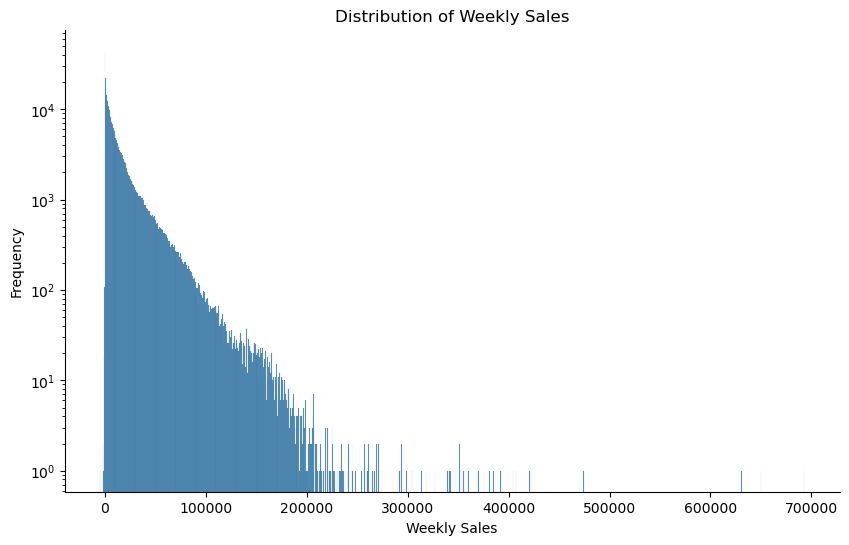

In [17]:
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.ticker import ScalarFormatter

x_array = df_sales.select('Weekly_Sales').rdd.flatMap(lambda x: x).collect()

fig, axs = plt.subplots(ncols=1, figsize=(10,6))
sns.despine(fig)
fig = sns.histplot(x_array).set_yscale('log')
plt.xlabel("Weekly Sales")
plt.ylabel("Frequency")
plt.title("Distribution of Weekly Sales") 
plt.show(fig)

### 1.2.3 Exploring the data<a class="anchor" id="1.1.1"></a>
[Back to top](#table)

Apart from that, Draw a line-plot to show the trend of the average weekly sales of the month based on the different stores

In [18]:
df1_sales = df_sales.withColumn('Month', f.month('Date'))
avg_weekly_sales = df1_sales.groupBy("Store","Month"). \
                            agg(f.mean("Weekly_Sales").alias("Average Sales"))

In [19]:
x_array = avg_weekly_sales.select('Month'). \
                            rdd.flatMap(lambda x: x).collect()
y_array = avg_weekly_sales.select('Average Sales'). \
                            rdd.flatMap(lambda x: x).collect()
color = avg_weekly_sales.select('Store'). \
                            rdd.flatMap(lambda x: x).collect()

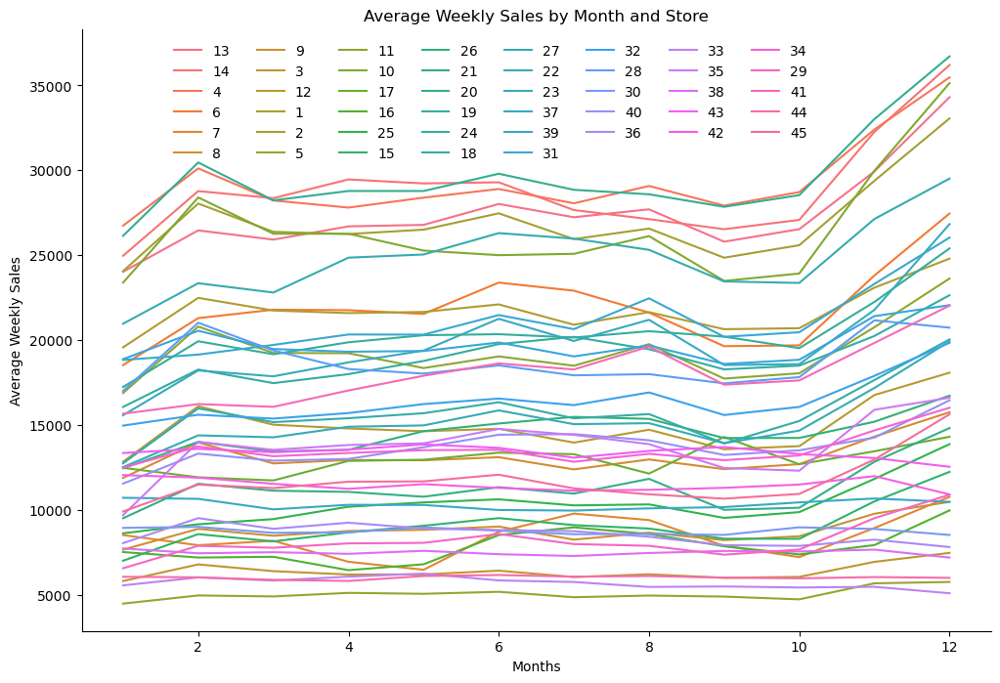

In [20]:
fig, axs = plt.subplots(ncols=1, figsize=(12, 8))
sns.despine(fig)
fig = sns.lineplot( x=x_array, y=y_array, hue=color)
plt.xlabel("Months")
plt.ylabel("Average Weekly Sales")
plt.title("Average Weekly Sales by Month and Store") 
sns.move_legend(fig, "upper center", 
                bbox_to_anchor=(.45, .995), ncol=8, title=None, frameon=False)
plt.show(fig)

### 1.2.4 Exploring the data<a class="anchor" id="1.1.1"></a>
[Back to top](#table)

Explore the data provided and write code to present two plots totally worthy of presenting to the MelbourneGig company, describe your plots and discuss the findings from the plots 

In [21]:
x_array = df_sales.select('Dept'). \
                            rdd.flatMap(lambda x: x).collect()
y_array = df_sales.select('Weekly_Sales'). \
                            rdd.flatMap(lambda x: x).collect()
color = df_sales.select('IsHoliday'). \
                            rdd.flatMap(lambda x: x).collect()

In [22]:
import plotly.express as px
fig = px.histogram(df_sales.toPandas(), x="Dept", y="Weekly_Sales", 
             color="IsHoliday", title="Holiday and Department Influence on Weekly Sales", 
             height=600, barmode='group')
fig.show() 

##### Plotting Correlation Plot

In [23]:
# At first Joining all data set

df_salesStores = df1_sales.join(df_stores,df1_sales.Store == df_stores.Store, how ="inner").\
                    drop(df_stores.Store)
df_salesStoresFeatures = df_salesStores.join(df_features,
                                             ((df_salesStores.Store == df_features.Store) 
                                             & (df_salesStores.Date == df_features.Date)), how = "left"). \
                                             drop(df_features.Store).drop(df_features.Date).drop(df_features.IsHoliday)
# Taking a subset of the joined data-set by stratified sampling
df_salesStoresFeatures = df_salesStoresFeatures.sampleBy("Type",{"A":0.5,"B":0.5,"C":0.5}, seed=1234)

# Changing data-type for plotting correlation based graphs (heatmap)
df_salesStoresFeatures=df_salesStoresFeatures.withColumn('IsHoliday', df_salesStoresFeatures.IsHoliday.cast('boolean'))
df_salesStoresFeatures=df_salesStoresFeatures.withColumn('Date', df_salesStoresFeatures.Date.cast('string'))

# Dropping cataegorical column
df_salesStoresFeatures = df_salesStoresFeatures.drop('Store','Date','Type','Dept','IsHoliday')

# Dropping NA values if any
df_salesStoresFeatures = df_salesStoresFeatures.na.drop("any")

In [24]:
correlation = df_salesStoresFeatures.toPandas().corr()

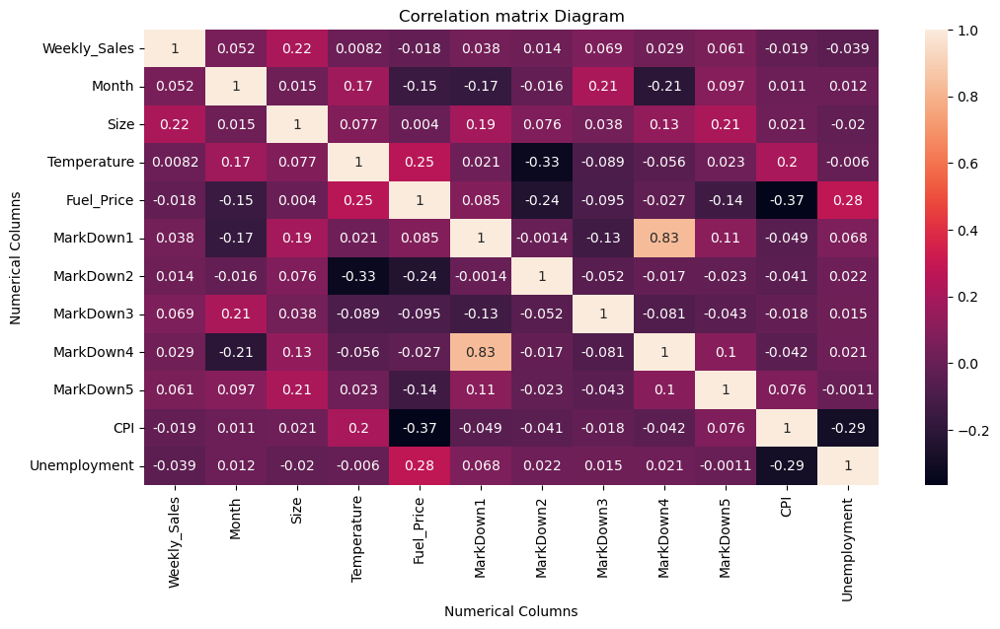

In [25]:
plt.figure(figsize=(12, 6))
heatmap = sns.heatmap(correlation, annot = True)  
heatmap.set (xlabel = 'Numerical Columns',
             ylabel = 'Numerical Columns', 
             title = "Correlation matrix Diagram")  
plt. show ()  

### 2.1.1 Discuss the feature selection and prepare the feature columns<a class="anchor" id="1.1.1"></a>
[Back to top](#table)

As we need to perform a one-step time-series prediction, meaning that the model’s prediction for the next weekly sales would be based on the previous weekly sales. The model will be used for future prediction Based on the data exploration from 1.2 and consider the situation we have, discuss which importances of those features (For example,which feature maybe useless and should be removed, which feature have a great impact to the label column,which features should be transformed) which features you are planning to use? Discuss the reasons for selecting them and how you create/transform them

Answer : is placed in Report Documentation Part

### 2.1.2 Discuss the feature selection and prepare the feature columns<a class="anchor" id="1.1.1"></a>
[Back to top](#table)
Write code to create the columns based on your discussion above

#### Use case 1: We need a model to predict stores which achieve the goals, which means the weekly sales of the store divide the Store size is greater than 8.5, create a column called "achieve_goal" and use 1 to label those achieved data, 0 for others’ data

In [26]:
df1_sales = df_sales.withColumn('Month', f.month('Date'))
df1_sales = df1_sales.withColumn('Year', f.year('Date'))
df_salesStores = df1_sales.join(df_stores, 
                               df1_sales.Store == df_stores.Store, how ="left").\
                               drop(df_stores.Store) #.drop('IsHoliday')

In [27]:
df_totalSales = df_salesStores.groupBy("Store","Date"). \
                    agg(f.sum("Weekly_Sales").alias("Total_Sales")). \
                    orderBy("Store")

In [28]:
df_salesStores = df_salesStores.join(df_totalSales, 
                                      ((df_salesStores.Store == df_totalSales.Store)
                                        & (df_salesStores.Date == df_totalSales.Date)),
                                       how = 'left'). \
                                      drop(df_totalSales.Store).drop(df_totalSales.Date)

In [29]:
df_salesStores  = df_salesStores. \
                        withColumn("Achieved_Goal", 
                                   when((col("Total_Sales")/
                                         col("Size")) > 8.5, 1).otherwise(0)). \
                        drop(df_salesStores.Total_Sales)

In [30]:
df_salesStoresFeatures = df_salesStores.join(df_features,
                                             ((df_salesStores.Store == df_features.Store)
                                            & (df_salesStores.Date == df_features.Date)), how = "left"). \
                                             drop(df_features.IsHoliday).drop(df_features.Store). \
                                             drop(df_features.Store).drop(df_features.Date)

#### Use case 2: Join the DataFrames for our one-step time-series weekly sales prediction for stores. You should make sure the weekly sales of the previous week and Store Type as the feature of our model. For other columns, you can choose based on your answer in 2.1.1

In [31]:
from pyspark.sql.window import Window
windowSpec  = Window.partitionBy("Store",'Dept').orderBy("Date")

In [32]:
from pyspark.sql.functions import lag    
df_salesStoresFeatures1 = df_salesStoresFeatures.withColumn("Previous_Weekly_Sales",
                                                            lag("Weekly_Sales",1).over(windowSpec)). \
                                                            drop('IsHoliday','MarkDown2','MarkDown4')

In [33]:
# Dropping any NA values in the data-set
df_salesStoresFeatures1 = df_salesStoresFeatures1.na.drop("any")

In [34]:
# Dropping any negative value of weekly sales, because sales can not be negative
df_salesStoresFeatures1 = df_salesStoresFeatures1. \
                                                filter(col('Previous_Weekly_Sales')>=0).\
                                                filter(col('Weekly_Sales')>=0)

### 2.2.1 Preparing Spark ML Transformers/Estimators for features, labels and models<a class="anchor" id="1.1.1"></a>
[Back to top](#table)
Write code to create Transformers/Estimators for transforming/assembling the columns you selected above in 2.1, and create ML model Estimators for Decision Tree and Gradient Boosted Tree model for each use case

#### StringIndexing categorical columns

In [35]:
from pyspark.ml.feature import StringIndexer
from pyspark.ml.feature import OneHotEncoder
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.classification import DecisionTreeClassifier
from pyspark.ml.classification import GBTClassifier
from pyspark.ml.regression import GBTRegressor
from pyspark.ml.regression import DecisionTreeRegressor

#######################################################
categoryInputCols =['Type','Dept','Month'] 
numericInputCols1 = ['Size','Fuel_Price','CPI','Unemployment',
                    'MarkDown1','MarkDown3', 'MarkDown5']
numericInputCols2 = ['Size','Fuel_Price','CPI','Unemployment','MarkDown1',
                    'MarkDown3', 'MarkDown5','Previous_Weekly_Sales']
categoryOutputCol = 'Achieved_Goal'
categoryCols = categoryInputCols+[categoryOutputCol]

###################################################
outputCols1=[f'{x}_index' for x in categoryInputCols if x!='Achieved_Goal']
outputCols1.append('label')
inputIndexer1 = StringIndexer(inputCols=categoryCols, outputCols=outputCols1)

outputCols2=[f'{x}_index' for x in categoryInputCols]
inputIndexer2 = StringIndexer(inputCols=categoryInputCols, outputCols=outputCols2)

######################################################
inputCols_OHE1 = [x for x in outputCols1 if x!='label']
outputCols_OHE1 = [f'{x}_vec' for x in categoryInputCols]
encoder1 = OneHotEncoder(inputCols=inputCols_OHE1,outputCols=outputCols_OHE1)

inputCols_OHE2 = [x for x in outputCols2]# if x!='label'] 
outputCols_OHE2 = [f'{x}_vec' for x in categoryInputCols]
encoder2 = OneHotEncoder(inputCols=inputCols_OHE2,outputCols=outputCols_OHE2)

#########################################################
assemblerInputs1 = outputCols_OHE1 + numericInputCols1
assembler1 = VectorAssembler(inputCols = assemblerInputs1, outputCol="features1")

assemblerInputs2 = outputCols_OHE2 + numericInputCols2
assembler2 = VectorAssembler(inputCols = assemblerInputs2, outputCol='features2')

###########################################################
dt = DecisionTreeClassifier(featuresCol = 'features1', labelCol = 'label', maxDepth = 10)
gbt = GBTClassifier(featuresCol="features1",labelCol="label",  maxIter=10, maxDepth =10)

dtr = DecisionTreeRegressor(featuresCol = 'features2', labelCol = 'Weekly_Sales', maxDepth = 30)
gbtr = GBTRegressor(featuresCol = 'features2', labelCol = 'Weekly_Sales', maxDepth = 20, maxIter=10)

### 2.2.2 Preparing Spark ML Transformers/Estimators for features, labels and models<a class="anchor" id="1.1.1"></a>
[Back to top](#table)
Write code to include the above Transformers/Estimators into pipelines

In [36]:
from pyspark.ml import Pipeline

stage_1 = inputIndexer1
stage_2 = encoder1
stage_3 = assembler1
stage_4 = dt
stage_5 = gbt

stages_dt = [stage_1,stage_2,stage_3,stage_4]
stages_gbt = [stage_1,stage_2,stage_3,stage_5]

model_dt = Pipeline(stages = stages_dt)
model_gbt = Pipeline(stages = stages_gbt)

### 2.3.1 Preparing the training data and testing data<a class="anchor" id="1.1.1"></a>
[Back to top](#table)
Write code to split the data for training and testing purpose - use the data in 2010 and 2012 for training purpose and the half data in 2011 year for training and others as testing purpose; then cache the training and testing data

In [37]:
# Sampling the data to create training set.
train_case = df_salesStoresFeatures1.sampleBy("Year",{2010:1,2011:0.5,2012:1}, seed=234)

In [38]:
test_case = df_salesStoresFeatures1.join(train_case, 
                                         ((df_salesStoresFeatures1.Date == train_case.Date) &
                                         (df_salesStoresFeatures1.Store == train_case.Store) &
                                         (df_salesStoresFeatures1.Dept == train_case.Dept)),
                                             how= "leftanti")

In [39]:
cached_train = train_case.cache()
cached_test = test_case.cache()

Answer: In the documentation